<p style="background-color: #800080; font-family: Georgia, serif; font-size: 24px; text-align: center; color: #FFD700; padding: 10px; border-radius: 20px; text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7);">
    Fetal Health Classification
</p>

In [2]:
!pip install xgboost
!pip install plotly

  Using cached xgboost-2.1.1-py3-none-win_amd64.whl (124.9 MB)



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


     --------------------------------------- 19.1/19.1 MB 13.4 MB/s eta 0:00:00


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier,VotingClassifier,StackingClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,matthews_corrcoef
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle
import plotly.graph_objs as go
import plotly.subplots as sp  


In [2]:
import pandas as pd
df=pd.read_csv('fetal_health.csv')
df

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.000,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.000,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.000,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.0,0.000,0.000,0.007,0.000,0.0,0.0,79.0,0.2,25.0,...,137.0,177.0,4.0,0.0,153.0,150.0,152.0,2.0,0.0,2.0
2122,140.0,0.001,0.000,0.007,0.000,0.0,0.0,78.0,0.4,22.0,...,103.0,169.0,6.0,0.0,152.0,148.0,151.0,3.0,1.0,2.0
2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,79.0,0.4,20.0,...,103.0,170.0,5.0,0.0,153.0,148.0,152.0,4.0,1.0,2.0
2124,140.0,0.001,0.000,0.006,0.000,0.0,0.0,78.0,0.4,27.0,...,103.0,169.0,6.0,0.0,152.0,147.0,151.0,4.0,1.0,2.0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In [9]:
df.isnull().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

<p style="background-color: #800080; font-family: Georgia, serif; font-size: 24px; text-align: center; color: #FFD700; padding: 10px; border-radius: 20px; text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7);">
    Exploratory Data Analysis (EDA)
</p>

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Univariate Analysis
</h1>


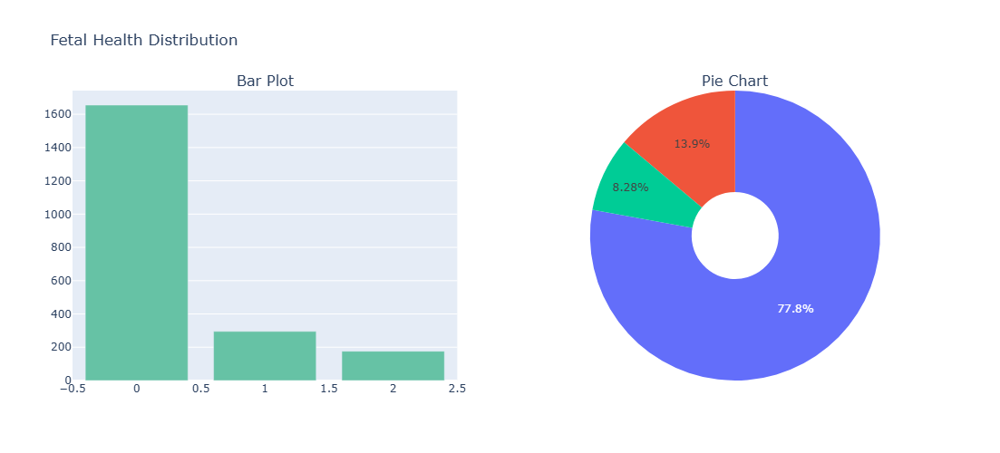

In [7]:
# Bar plot for fetal_health value counts
 
bar_fig = go.Bar(
    x=(df['fetal_health']-1).value_counts().index,
    y=(df['fetal_health']-1).value_counts().values,
    marker=dict(color='#66C2A5')
)

# Pie chart for fetal_health value counts
pie_fig = go.Pie(
    labels=(df['fetal_health']-1).value_counts().index,
    values=(df['fetal_health']-1).value_counts().values,
    hole=0.3  # Optional: for a donut-style pie chart
)

# Create subplots with Plotly
fig = sp.make_subplots(
    rows=1, cols=2,
    subplot_titles=("Bar Plot", "Pie Chart"),
    specs=[[{"type": "bar"}, {"type": "pie"}]]
)

# Add the bar plot to the first subplot
fig.add_trace(bar_fig, row=1, col=1)

# Add the pie chart to the second subplot
fig.add_trace(pie_fig, row=1, col=2)

# Update layout for better visualization
fig.update_layout(
    title_text="Fetal Health Distribution",
    showlegend=False,  # Hide legend to avoid redundancy in pie chart
    height=500,
    width=700
)

# Show the figure
fig.show()


<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Visualizing Data Distributions with <code>histplot</code>
</h1>


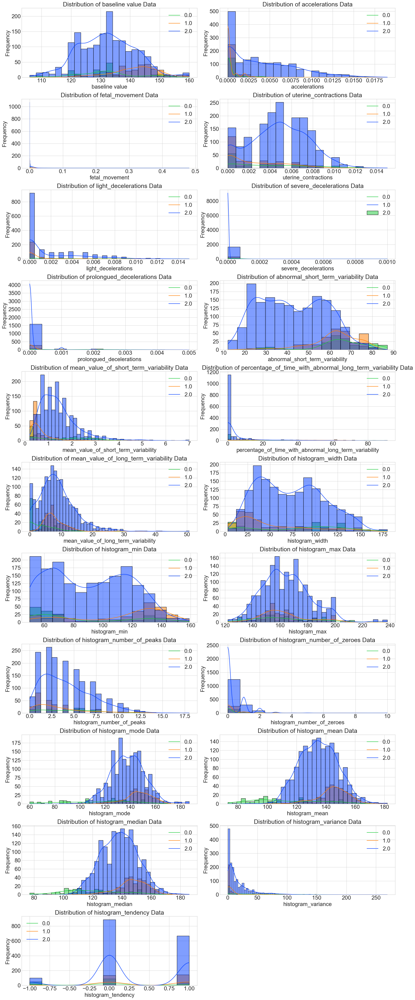

In [8]:
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Suppress warnings
warnings.filterwarnings('ignore')

# Set seaborn style
plt.style.use('seaborn-v0_8-whitegrid')

# Drop the target variable from the features
X = df.drop('fetal_health', axis=1)

# Create the figure
plt.figure(figsize=(20, 50))
num_row = 1

# Loop through each column to create the subplots
for col in X.columns:
    plt.subplot(11, 2, num_row)
    
    # Set title with larger font size
    plt.title(f"Distribution of {col} Data", fontsize=22)  
    
    # Plot histogram with KDE and hue
    sns.histplot(x=df[col], kde=True, hue=df['fetal_health'], palette='bright')
    
    # Set x and y axis labels with larger font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('Frequency', fontsize=20)
    
    # Set larger font size for ticks
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    
    # Set larger font size for the legend
    plt.legend(df['fetal_health'].value_counts().index-1,title_fontsize='20', fontsize='20')
    #plt.legend(title='fetal_health',title_fontsize='15', fontsize='15')
    # Adjust layout
    plt.tight_layout()
    
    num_row += 1

# Show the plots

plt.show()


<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Visualizing Data Distributions with <code>Box-Plot</code>
</h1>

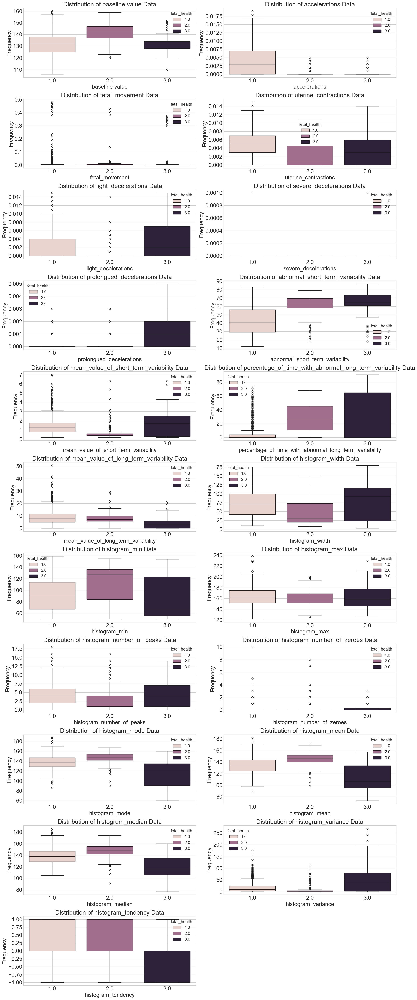

In [9]:
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Suppress warnings
warnings.filterwarnings('ignore')

# Set seaborn style
plt.style.use('seaborn-v0_8-whitegrid')

# Drop the target variable from the features
X = df.drop('fetal_health', axis=1)

# Create the figure
plt.figure(figsize=(20, 50))
num_row = 1

# Loop through each column to create the subplots
for col in X.columns:
    plt.subplot(11, 2, num_row)
    
    # Set title with larger font size
    plt.title(f"Distribution of {col} Data", fontsize=22)  
    
    # Plot histogram with KDE and hue
    sns.boxplot(y=df[col], x=df['fetal_health'],hue=df['fetal_health'])
    
    # Set x and y axis labels with larger font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('Frequency', fontsize=20)
    
    # Set larger font size for ticks
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    
    # Set larger font size for the legend
    plt.legend(title='fetal_health',title_fontsize='15', fontsize='15')
    
    # Adjust layout
    plt.tight_layout()
    
    num_row += 1

# Show the plots

plt.show()

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  Bivariate Analysis with <code>pairplot</code>
</h1>

In [10]:
sns.pairplot(df, hue='fetal_health', corner=True, palette='bright', height=5)  


plt.show()

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  Bivariate Analysis with <code>Heatmap</code>
</h1>

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the figure
plt.figure(figsize=(30, 30))

# Plot the heatmap
sns.heatmap(df.corr(), annot=True, cmap='viridis')

 
plt.xticks(fontsize=30)   
plt.yticks(fontsize=30)   

# Show the plot
plt.show()


KeyboardInterrupt: 

In [ ]:
#Feature Selection

In [52]:
df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


In [31]:
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest

# Assuming df contains 22 feature columns and the 23rd column (index 22) is the target variable
X = df.iloc[:,:21]  # First 22 columns as features
y = df.iloc[:,21]   # 23rd column as target

# Apply ANOVA F-test
f_values, p_values = f_classif(X, y)

# View F-statistic and p-values for each feature
print("F-values:", f_values)  # F-statistics for each feature
print("P-values:", p_values)  # P-values for each feature

# Select the top 2 features based on F-statistic
selector = SelectKBest(f_classif, k=11)
X_new = selector.fit_transform(X, y)

# View the selected features
print("Selected Features:\n", X_new)


F-values: [140.62107554 196.02752286  11.67979674  93.71574343  66.8647544
  28.44815599 505.85320559 343.82041888 119.88200625 345.15638463
  70.17409253  55.08824088  87.34050293   2.46492257  12.10483413
   2.19637321 275.11769592 297.62549657 248.77223747 150.79684904
  44.54229403]
P-values: [4.45709780e-058 7.52061244e-079 9.02053230e-006 9.93571078e-040
 6.90114804e-029 6.42359611e-013 2.21023801e-180 4.47236781e-130
 4.69591240e-050 1.63114782e-130 3.08205407e-030 4.73811927e-024
 3.53480992e-037 8.52587029e-002 5.92496638e-006 1.11458377e-001
 5.72042916e-107 1.14566006e-114 8.60606510e-098 5.79628864e-062
 1.12300695e-019]
Selected Features:
 [[1.20e+02 0.00e+00 0.00e+00 ... 1.37e+02 1.21e+02 7.30e+01]
 [1.32e+02 6.00e-03 6.00e-03 ... 1.36e+02 1.40e+02 1.20e+01]
 [1.33e+02 3.00e-03 8.00e-03 ... 1.35e+02 1.38e+02 1.30e+01]
 ...
 [1.40e+02 1.00e-03 7.00e-03 ... 1.48e+02 1.52e+02 4.00e+00]
 [1.40e+02 1.00e-03 6.00e-03 ... 1.47e+02 1.51e+02 4.00e+00]
 [1.42e+02 2.00e-03 8.00e-03 

In [32]:
selected_mask = selector.get_support()

# Get the selected feature names
selected_features = X.columns[selected_mask]

# View the selected features
print("Selected Feature Names:", selected_features)

Selected Feature Names: Index(['baseline value', 'accelerations', 'uterine_contractions',
       'prolongued_decelerations', 'abnormal_short_term_variability',
       'mean_value_of_short_term_variability',
       'percentage_of_time_with_abnormal_long_term_variability',
       'histogram_mode', 'histogram_mean', 'histogram_median',
       'histogram_variance'],
      dtype='object')


In [45]:
X_new.shape

(2126, 2)

In [46]:
y.value_counts()

fetal_health
1.0    1655
2.0     295
3.0     176
Name: count, dtype: int64

In [12]:
!pip install imblearn

     -------------------------------------- 258.3/258.3 kB 2.6 MB/s eta 0:00:00



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [13]:
from imblearn.combine import SMOTEENN

In [14]:
import pandas as pd
from sklearn.feature_selection import f_classif, SelectKBest
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, matthews_corrcoef
from xgboost import XGBClassifier

# Assuming df contains your features and target variable
X = df.iloc[:, :21]  # First 21 columns as features
y = df.iloc[:, 21]   # 22nd column as target

# Ensure y is numeric
y_adjusted = y - 1  # Adjusting y if it's starting from 1 (making it 0-indexed)

# Apply ANOVA F-test
f_values, p_values = f_classif(X, y)
print("F-values:", f_values)
print("P-values:", p_values)

# Lists to store results
results_list = []

# Loop over k values for feature selection
for i in range(1, 21):
    # Select K best features
    selector = SelectKBest(f_classif, k=i)
    X_new = selector.fit_transform(X, y)
    
    # Scaling the features
    # Step 1: Scale the data
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    # Step 2: Apply SMOTEENN to resample the scaled data
    smote_enn = SMOTEENN(random_state=42)
    X_resampled, y_resampled = smote_enn.fit_resample(X_scaled, y_adjusted)
    
    # Step 3: Split the resampled data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

    # Initialize models
    log_model = LogisticRegression(random_state=42)
    svm_model = SVC(random_state=42, probability=True)
    rf_model = RandomForestClassifier(random_state=42)
    knn_model = KNeighborsClassifier()
    xgb_model = XGBClassifier(random_state=42, eval_metric='mlogloss')
    
    # Fit and evaluate each model
    models = {
        'Logistic Regression': log_model,
        'SVM': svm_model,
        'Random Forest': rf_model,
        'KNN': knn_model,
        'XGBoost': xgb_model
    }
    
    intermedacclist = []
    intermedmathew = []
    
    for name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        mcc = matthews_corrcoef(y_test, y_pred)
        
        intermedacclist.append(accuracy)
        intermedmathew.append(mcc)
    
    # Voting Classifier (ensemble)
    voting_model = VotingClassifier(estimators=[
        ('xgb', XGBClassifier(random_state=42, eval_metric='mlogloss')),
        ('rf', RandomForestClassifier(random_state=42))
    ], voting='soft')
    
    voting_model.fit(X_train, y_train)
    voting_y_pred = voting_model.predict(X_test)
    voting_accuracy = accuracy_score(y_test, voting_y_pred)
    mcc_voting = matthews_corrcoef(y_test, voting_y_pred)
    
    intermedacclist.append(voting_accuracy)
    intermedmathew.append(mcc_voting)
    
    # Stacking Classifier (ensemble)
    stacking_model = StackingClassifier(estimators=[
        ('xgb', XGBClassifier(random_state=42, eval_metric='mlogloss')),
        ('rf', RandomForestClassifier(random_state=42))
    ], final_estimator=LogisticRegression(), cv=5)
    
    stacking_model.fit(X_train, y_train)
    stacking_y_pred = stacking_model.predict(X_test)
    stacking_accuracy = accuracy_score(y_test, stacking_y_pred)
    mcc_stacking = matthews_corrcoef(y_test, stacking_y_pred)
    
    intermedacclist.append(stacking_accuracy)
    intermedmathew.append(mcc_stacking)
    
    # Append results for this k value
    results_list.append({
        'k': i,
        'Logistic Regression Accuracy': intermedacclist[0],
        'Logistic Regression MCC': intermedmathew[0],
        'SVM Accuracy': intermedacclist[1],
        'SVM MCC': intermedmathew[1],
        'Random Forest Accuracy': intermedacclist[2],
        'Random Forest MCC': intermedmathew[2],
        'KNN Accuracy': intermedacclist[3],
        'KNN MCC': intermedmathew[3],
        'XGBoost Accuracy': intermedacclist[4],
        'XGBoost MCC': intermedmathew[4],
        'Voting Classifier Accuracy': intermedacclist[5],
        'Voting Classifier MCC': intermedmathew[5],
        'Stacking Classifier Accuracy': intermedacclist[6],
        'Stacking Classifier MCC': intermedmathew[6]
    })

# Convert results to a DataFrame for comparison
results_df = pd.DataFrame(results_list)

# Display the DataFrame
print(results_df)


F-values: [140.62107554 196.02752286  11.67979674  93.71574343  66.8647544
  28.44815599 505.85320559 343.82041888 119.88200625 345.15638463
  70.17409253  55.08824088  87.34050293   2.46492257  12.10483413
   2.19637321 275.11769592 297.62549657 248.77223747 150.79684904
  44.54229403]
P-values: [4.45709780e-058 7.52061244e-079 9.02053230e-006 9.93571078e-040
 6.90114804e-029 6.42359611e-013 2.21023801e-180 4.47236781e-130
 4.69591240e-050 1.63114782e-130 3.08205407e-030 4.73811927e-024
 3.53480992e-037 8.52587029e-002 5.92496638e-006 1.11458377e-001
 5.72042916e-107 1.14566006e-114 8.60606510e-098 5.79628864e-062
 1.12300695e-019]
     k  Logistic Regression Accuracy  Logistic Regression MCC  SVM Accuracy  \
0    1                      0.895811                 0.843612      0.961332   
1    2                      0.895811                 0.843612      0.961332   
2    3                      0.895811                 0.843612      0.961332   
3    4                      0.895811       

In [16]:
results_df

,k,Logistic Regression Accuracy,Logistic Regression MCC,SVM Accuracy,SVM MCC,Random Forest Accuracy,Random Forest MCC,KNN Accuracy,KNN MCC,XGBoost Accuracy,XGBoost MCC,Voting Classifier Accuracy,Voting Classifier MCC,Stacking Classifier Accuracy,Stacking Classifier MCC
0,1,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
1,2,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
2,3,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
3,4,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
4,5,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
5,6,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
6,7,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
7,8,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
8,9,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321
9,10,0.895811,0.843612,0.961332,0.942235,0.991407,0.987096,0.982814,0.97434,0.989259,0.98387,0.992481,0.988709,0.993555,0.990321


In [30]:
X = df.iloc[:, :21]  # First 21 columns as features
y = df.iloc[:, 21]   # 22nd column as target

# Ensure y is numeric
y_adjusted = y - 1  # Adjusting y if it's starting from 1 (making it 0-indexed)

# Apply feature selection
f_values, p_values = f_classif(X, y_adjusted)

for i in range(1,21):
    selector = SelectKBest(f_classif, k=i)
    X_new = selector.fit_transform(X, y_adjusted)
    
    # Scaling the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_new)
    
    # Resample using SMOTEENN
    smote_enn = SMOTEENN(random_state=42)
    X_resampled, y_resampled = smote_enn.fit_resample(X_scaled, y_adjusted)
    
    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)
    
    # Initialize XGBoost model
    xgb_model = XGBClassifier(random_state=42, eval_metric='mlogloss')
    
    # Fit the model
    xgb_model.fit(X_train, y_train)
    
    # Predict and evaluate
    y_pred = xgb_model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    
    # Print results
    print("i",i)
    print("----Accuracy:", accuracy)
#     print("Matthews Correlation Coefficient:", mcc)
    

i 1
----Accuracy: 0.9974160206718347
i 2
----Accuracy: 0.9858299595141701
i 3
----Accuracy: 0.9853479853479854
i 4
----Accuracy: 0.9832402234636871
i 5
----Accuracy: 0.9901639344262295
i 6
----Accuracy: 0.991304347826087
i 7
----Accuracy: 0.9893276414087513
i 8
----Accuracy: 0.9946466809421841
i 9
----Accuracy: 0.9925373134328358
i 10
----Accuracy: 0.9936507936507937
i 11
----Accuracy: 0.9968119022316685
i 12
----Accuracy: 0.9872068230277186
i 13
----Accuracy: 0.9914893617021276
i 14
----Accuracy: 0.9946638207043756
i 15
----Accuracy: 0.9914712153518124
i 16
----Accuracy: 0.9914712153518124
i 17
----Accuracy: 0.987220447284345
i 18
----Accuracy: 0.9893617021276596
i 19
----Accuracy: 0.9882854100106496
i 20
----Accuracy: 0.9914529914529915


In [35]:
X = df.iloc[:, :21]  # First 21 columns as features
y = df.iloc[:, 21]   # 22nd column as target

# Ensure y is numeric
y_adjusted = y - 1  # Adjusting y if it's starting from 1 (making it 0-indexed)

# Apply feature selection
f_values, p_values = f_classif(X, y_adjusted)
selector = SelectKBest(f_classif, k=11)
X_new = selector.fit_transform(X, y_adjusted)

# Scaling the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_new)

# Resample using SMOTEENN
smote_enn = SMOTEENN(random_state=42)
X_resampled, y_resampled = smote_enn.fit_resample(X_scaled, y_adjusted)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Initialize XGBoost model
xgb_model = XGBClassifier(random_state=42, eval_metric='mlogloss')

# Fit the model
xgb_model.fit(X_train, y_train)

# Predict and evaluate
y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
mcc = matthews_corrcoef(y_test, y_pred)

print(accuracy)

0.9968119022316685


In [36]:
import pickle

with open("model_fetal_health_new.pkl", "wb") as f:
    pickle.dump(xgb_model, f)

In [ ]:
#-----------------------------------------------------

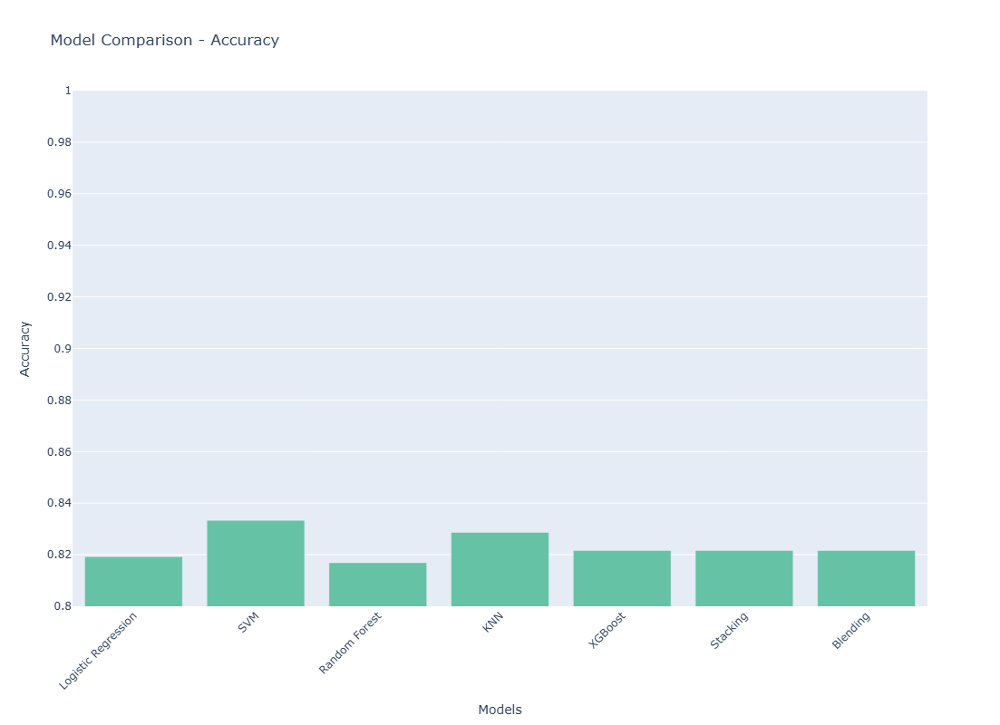

In [49]:
import plotly.graph_objs as go

# Data for the bar plot
models = ['Logistic Regression', 'SVM', 'Random Forest', 'KNN', 'XGBoost', 'Stacking', 'Blending']
accuracies = [log_accuracy, svm_accuracy, rf_accuracy, knn_accuracy, xgb_accuracy, stacking_accuracy, voting_accuracy]

# Create a bar plot
bar_fig = go.Figure()

# Add bar trace
bar_fig.add_trace(go.Bar(
    x=models,
    y=accuracies,
    marker_color='#66C2A5'
))

# Update layout with increased size
bar_fig.update_layout(
    title='Model Comparison - Accuracy',
    xaxis_title='Models',
    yaxis_title='Accuracy',
    yaxis=dict(range=[0.8, 1.0]),  # Set y-axis limits
    xaxis_tickangle=-45,  # Rotate x-axis labels for better readability
    width=800,  # Increase width
    height=800   # Increase height
)

# Show the figure
bar_fig.show()


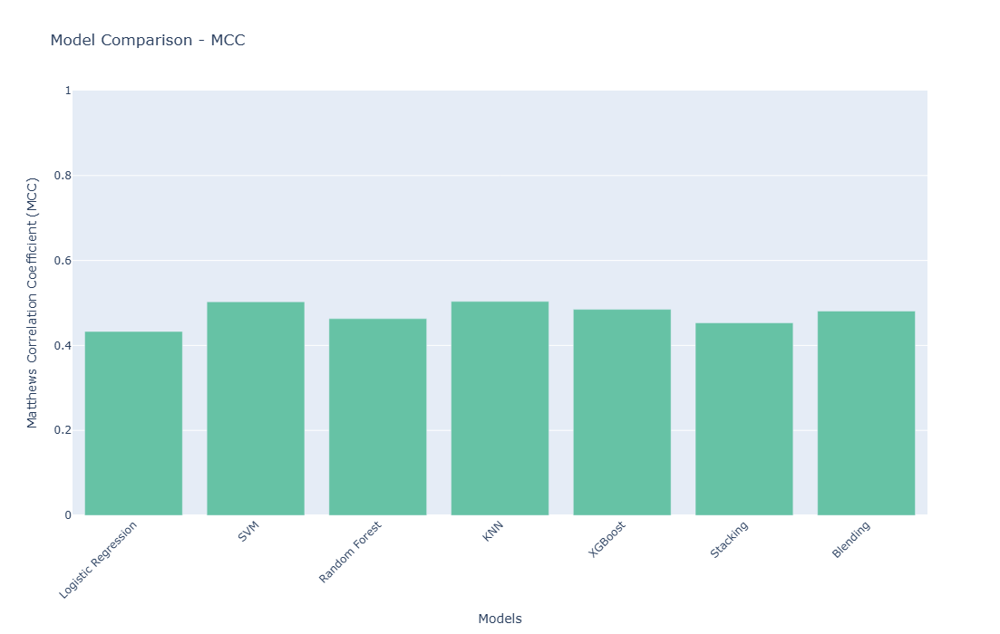

In [50]:
# Model names and corresponding MCC values
models = ['Logistic Regression', 'SVM', 'Random Forest', 'KNN', 'XGBoost', 'Stacking', 'Blending']
mcc_values = [mcc_log, mcc_svm, mcc_rf, mcc_knn, mcc_XGb, mcc_stacking, mcc_voting]

# Create a bar plot
mcc_fig = go.Figure()

# Add bar trace
mcc_fig.add_trace(go.Bar(
    x=models,
    y=mcc_values,
    marker_color='#66C2A5'
))

# Update layout with increased size
mcc_fig.update_layout(
    title='Model Comparison - MCC',
    xaxis_title='Models',
    yaxis_title='Matthews Correlation Coefficient (MCC)',
    yaxis=dict(range=[0.0, 1.0]),  # Set y-axis limits
    xaxis_tickangle=-45,  # Rotate x-axis labels for better readability
    width=800,  # Increase width
    height=700   # Increase height
)

# Show the figure
mcc_fig.show()



In [51]:
d={'Models':models,'Accuracies':accuracies,'MCC':mcc_values}
Models_comparison=pd.DataFrame(d)


from IPython.display import display, HTML
# Sort the DataFrame by 'Accuracies' and reset the index
Models_comparison_sorted = Models_comparison.sort_values(by='Accuracies', ascending=False).reset_index(drop=True)
# Define the HTML table string with inline CSS styling
html_table = """
<table style="width:60%; margin:auto; border-collapse:collapse; font-family:Georgia, serif; font-size:18px; text-align:center;">
  <thead>
    <tr style="background-color:#4A90E2; color:white; border:2px solid #66C2A5;">
      <th style="padding:12px;">Models</th>
      <th style="padding:12px;">Accuracies</th>
      <th style="padding:12px;">MCC</th>
    </tr>
  </thead>
  <tbody>
"""
# Add table rows dynamically from the DataFrame
for _, row in Models_comparison_sorted.iterrows():
    html_table += f"""
    <tr style="border-bottom:1px solid #ddd;">
      <td style="padding:12px; background-color:#E6F9E6;">{row['Models']}</td>
      <td style="padding:12px; background-color:#F0F4C3;">{row['Accuracies']:.6f}</td>
      <td style="padding:12px; background-color:#E6F9E6;">{row['MCC']:.6f}</td>
    </tr>
    """
# Close the HTML table
html_table += """
  </tbody>
</table>
"""
# Display the HTML table
display(HTML(html_table))

Models,Accuracies,MCC
SVM,0.833333,0.502825
KNN,0.828638,0.503539
XGBoost,0.821596,0.484844
Stacking,0.821596,0.453307
Blending,0.821596,0.481004
Logistic Regression,0.819249,0.432804
Random Forest,0.816901,0.463002


<p style="background-color: #800080; font-family: Georgia, serif; font-size: 24px; text-align: center; color: #FFD700; padding: 10px; border-radius: 20px; text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7);">
    Model Training and Prediction
</p>

In [28]:
# Splitting data into features and target
# X = df.drop(columns=['fetal_health'])
# y = df['fetal_health']
y=y-1
# Scaling the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_new)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42,stratify=y)



In [29]:
def plot_multi_class_roc(model, X_test, y_test, num_classes=3):
    # Binarize the labels for multi-class ROC calculation
    y_test_bin = label_binarize(y_test, classes=[0, 1, 2])
    y_pred_proba = model.predict_proba(X_test)
    
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    # Compute ROC curve and ROC area for each class
    for i in range(num_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Plot ROC curve for each class
    plt.figure(figsize=(8, 6))
    colors = cycle(['blue', 'red', 'green'])
    
    for i, color in zip(range(num_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'Class {i+1} (AUC = {roc_auc[i]:.4f})')

    # Plot the diagonal (random classifier)
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Multi-Class ROC Curve')
    plt.legend(loc="lower right")
    plt.show()


<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Logistic Regression 
</h1>

In [30]:
# Logistic Regression
log_model = LogisticRegression(random_state=42)
log_model.fit(X_train, y_train)
log_y_pred = log_model.predict(X_test)
log_accuracy = accuracy_score(y_test, log_y_pred)

# Logistic Regression - Classification Report & Confusion Matrix
print("Logistic Regression Classification Report")
print(classification_report(y_test, log_y_pred))
print("Logistic Regression Confusion Matrix")
print(confusion_matrix(y_test, log_y_pred))


# Calculate MCC for the model's predictions
mcc_log = matthews_corrcoef(y_test, log_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_log:.4f}")

Logistic Regression Classification Report
              precision    recall  f1-score   support

         0.0       0.94      0.94      0.94       332
         1.0       0.61      0.66      0.63        59
         2.0       0.86      0.69      0.76        35

    accuracy                           0.88       426
   macro avg       0.80      0.76      0.78       426
weighted avg       0.89      0.88      0.88       426

Logistic Regression Confusion Matrix
[[313  17   2]
 [ 18  39   2]
 [  3   8  24]]
Matthews Correlation Coefficient (MCC): 0.6769


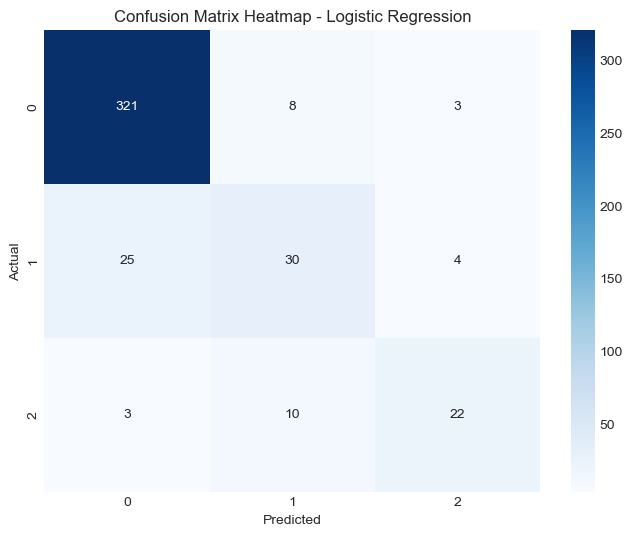

In [22]:
def plot_confusion_matrix_heatmap(y_test, y_pred, model_name):
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1, 2], yticklabels=[0, 1, 2])
    plt.title(f'Confusion Matrix Heatmap - {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()
plot_confusion_matrix_heatmap(y_test, log_y_pred, 'Logistic Regression')

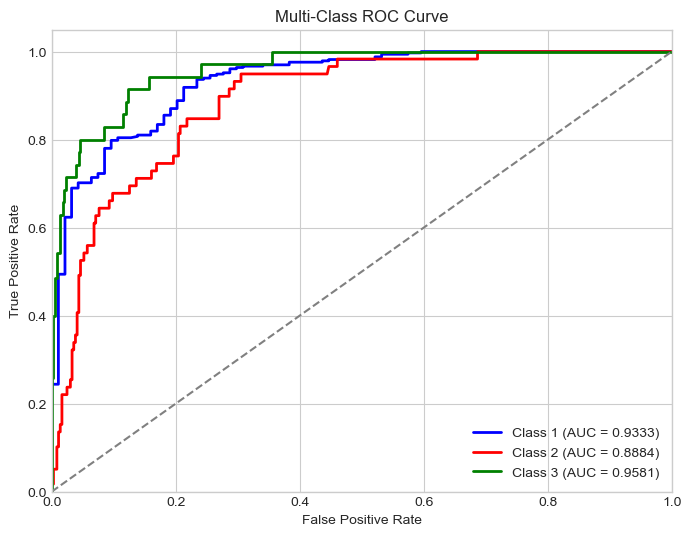

In [23]:
plot_multi_class_roc(log_model, X_test, y_test, num_classes=3)

In [93]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.datasets import make_classification
from itertools import cycle

# Create a multi-class classification dataset for demonstration
X, y = make_classification(n_samples=1000, n_features=20, n_classes=3, n_informative=3, random_state=42)

# Binarize the output labels for multi-class ROC calculation
y_bin = label_binarize(y, classes=[0, 1, 2])
n_classes = y_bin.shape[1]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_new, y_bin, test_size=0.2, random_state=42)

# Fit a classifier (e.g., Logistic Regression)
model = LogisticRegression(multi_class='ovr')
model.fit(X_train, y_train)

# Get predicted probabilities for the test set
y_score = model.predict_proba(X_test)

# Initialize dictionaries to store FPR, TPR, and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

# Compute ROC curve and AUC for each class
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot the ROC curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'red', 'green'])  # Colors for each class

for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

# Plot the diagonal line (random classifier)
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')

# Add labels and title
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multi-Class ROC Curve')
plt.legend(loc="lower right")
plt.show()


ValueError: Found input variables with inconsistent numbers of samples: [2126, 1000]

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Support Vector Machine (SVM)
</h1>

In [28]:
# Support Vector Machine (SVM)
svm_model = SVC(random_state=42, probability=True)
svm_model.fit(X_train, y_train)
svm_y_pred = svm_model.predict(X_test)
svm_accuracy = accuracy_score(y_test, svm_y_pred)

# Support Vector Machine (SVM) - Classification Report & Confusion Matrix
print(svm_accuracy)
print("SVM Classification Report")
print(classification_report(y_test, svm_y_pred))
print("SVM Confusion Matrix")
print(confusion_matrix(y_test, svm_y_pred))

# Calculate MCC for the model's predictions
mcc_svm = matthews_corrcoef(y_test,svm_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_svm:.4f}")

0.8967136150234741
SVM Classification Report
              precision    recall  f1-score   support

         1.0       0.93      0.95      0.94       333
         2.0       0.68      0.69      0.68        64
         3.0       0.96      0.76      0.85        29

    accuracy                           0.90       426
   macro avg       0.86      0.80      0.82       426
weighted avg       0.90      0.90      0.90       426

SVM Confusion Matrix
[[316  17   0]
 [ 19  44   1]
 [  3   4  22]]
Matthews Correlation Coefficient (MCC): 0.7081


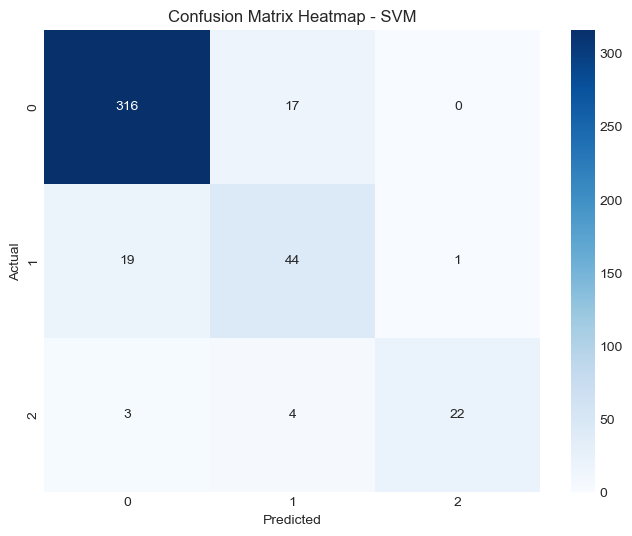

In [29]:
plot_confusion_matrix_heatmap(y_test, svm_y_pred, 'SVM')

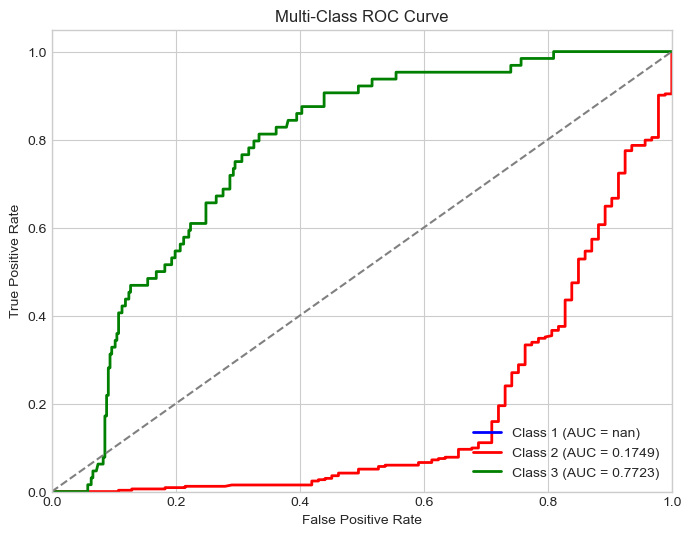

In [30]:
plot_multi_class_roc(svm_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Random Forest 
</h1>

In [31]:
# Random Forest
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)
rf_y_pred = rf_model.predict(X_test)
rf_accuracy = accuracy_score(y_test, rf_y_pred)

# Random Forest - Classification Report & Confusion Matrix
print("Random Forest Classification Report")
print(classification_report(y_test, rf_y_pred))
print("Random Forest Confusion Matrix")
print(confusion_matrix(y_test, rf_y_pred))

# Calculate MCC for the model's predictions
mcc_rf = matthews_corrcoef(y_test,rf_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_rf:.4f}")

Random Forest Classification Report
              precision    recall  f1-score   support

         1.0       0.97      0.97      0.97       333
         2.0       0.87      0.83      0.85        64
         3.0       0.90      0.93      0.92        29

    accuracy                           0.95       426
   macro avg       0.91      0.91      0.91       426
weighted avg       0.95      0.95      0.95       426

Random Forest Confusion Matrix
[[324   7   2]
 [ 10  53   1]
 [  1   1  27]]
Matthews Correlation Coefficient (MCC): 0.8563


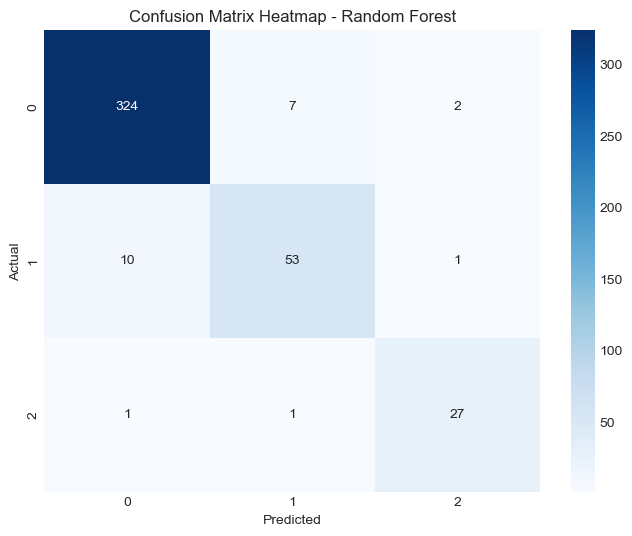

In [32]:
plot_confusion_matrix_heatmap(y_test, rf_y_pred, 'Random Forest')

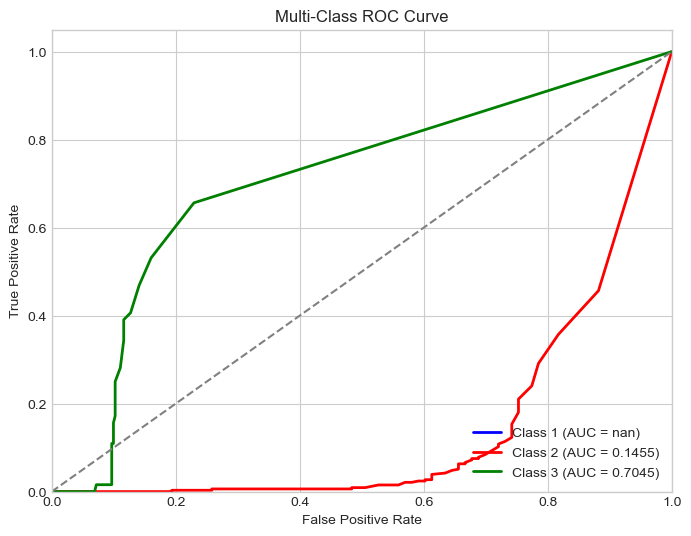

In [33]:
plot_multi_class_roc(rf_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● K-Nearest Neighbors (KNN)
</h1>

In [34]:
# K-Nearest Neighbors (KNN)
knn_model = KNeighborsClassifier()
knn_model.fit(X_train, y_train)
knn_y_pred = knn_model.predict(X_test)
knn_accuracy = accuracy_score(y_test, knn_y_pred)

# K-Nearest Neighbors (KNN) - Classification Report & Confusion Matrix
print("KNN Classification Report")
print(classification_report(y_test, knn_y_pred))
print("KNN Confusion Matrix")
print(confusion_matrix(y_test, knn_y_pred))

# Calculate MCC for the model's predictions
mcc_knn = matthews_corrcoef(y_test,knn_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_knn:.4f}")

KNN Classification Report
              precision    recall  f1-score   support

         1.0       0.96      0.98      0.97       333
         2.0       0.85      0.80      0.82        64
         3.0       0.93      0.90      0.91        29

    accuracy                           0.94       426
   macro avg       0.91      0.89      0.90       426
weighted avg       0.94      0.94      0.94       426

KNN Confusion Matrix
[[325   8   0]
 [ 11  51   2]
 [  2   1  26]]
Matthews Correlation Coefficient (MCC): 0.8414


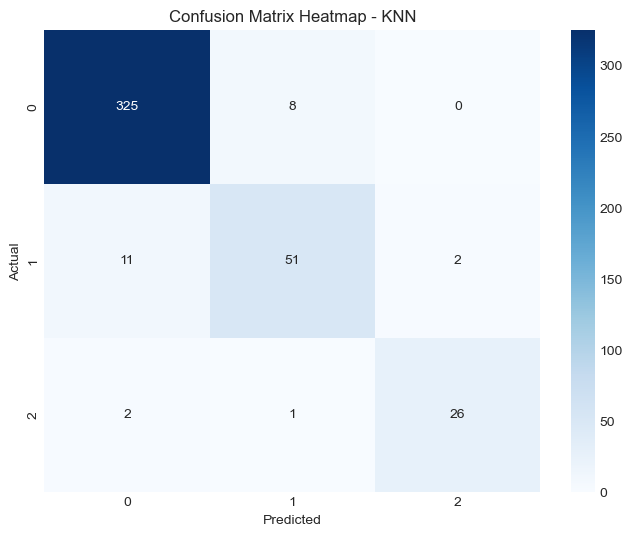

In [35]:
plot_confusion_matrix_heatmap(y_test, knn_y_pred, 'KNN')

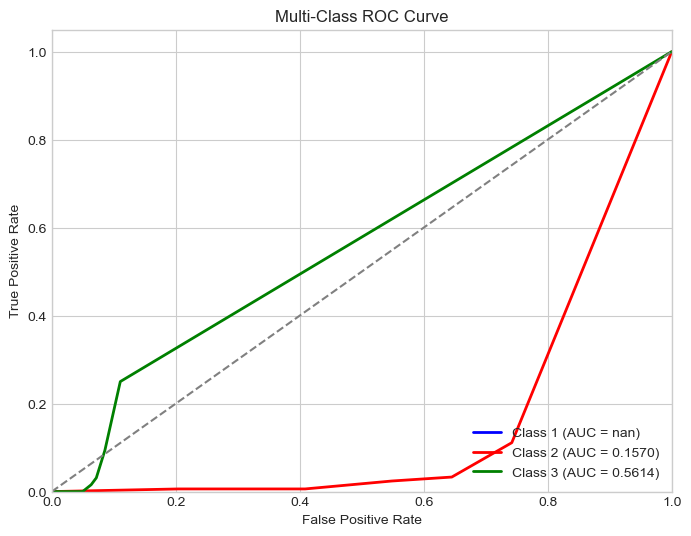

In [36]:
plot_multi_class_roc(knn_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● XGBoost 
</h1>

In [37]:
# XGBoost
xgb_model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='mlogloss')
xgb_model.fit(X_train, y_train)
xgb_y_pred = xgb_model.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_y_pred)

# XGBoost - Classification Report & Confusion Matrix

print("XGBoost Classification Report")
print(classification_report(y_test, xgb_y_pred))
print("XGBoost Confusion Matrix")
print(confusion_matrix(y_test, xgb_y_pred))

# Calculate MCC for the model's predictions
mcc_XGb = matthews_corrcoef(y_test,xgb_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_XGb:.4f}")

ValueError: Invalid classes inferred from unique values of `y`.  Expected: [0 1 2], got [1. 2. 3.]

In [ ]:
plot_confusion_matrix_heatmap(y_test, xgb_y_pred, 'XGBoost')

In [ ]:
plot_multi_class_roc(xgb_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Blending (Voting Classifier) 
</h1>

In [38]:
# Blending (Voting Classifier)
voting_model = VotingClassifier(
    estimators=[('xgb', xgb_model), ('rf', rf_model)],
    voting='soft'  # soft voting averages the predicted probabilities
)
voting_model.fit(X_train, y_train)

# Predictions
voting_y_pred = voting_model.predict(X_test)

# Accuracy
voting_accuracy = accuracy_score(y_test, voting_y_pred)

# Classification Report & Confusion Matrix for Blending
print("Blending (Voting) Classification Report")
print(classification_report(y_test, voting_y_pred))
print("Blending (Voting) Confusion Matrix")
print(confusion_matrix(y_test, voting_y_pred))

# Accuracy of Blending
print(f"Blending Accuracy: {voting_accuracy:.4f}")

# Calculate MCC for the model's predictions
mcc_voting = matthews_corrcoef(y_test,voting_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_voting:.4f}")

Blending (Voting) Classification Report
              precision    recall  f1-score   support

         1.0       0.97      0.97      0.97       333
         2.0       0.88      0.83      0.85        64
         3.0       0.91      1.00      0.95        29

    accuracy                           0.95       426
   macro avg       0.92      0.93      0.93       426
weighted avg       0.95      0.95      0.95       426

Blending (Voting) Confusion Matrix
[[324   7   2]
 [ 10  53   1]
 [  0   0  29]]
Blending Accuracy: 0.9531
Matthews Correlation Coefficient (MCC): 0.8701


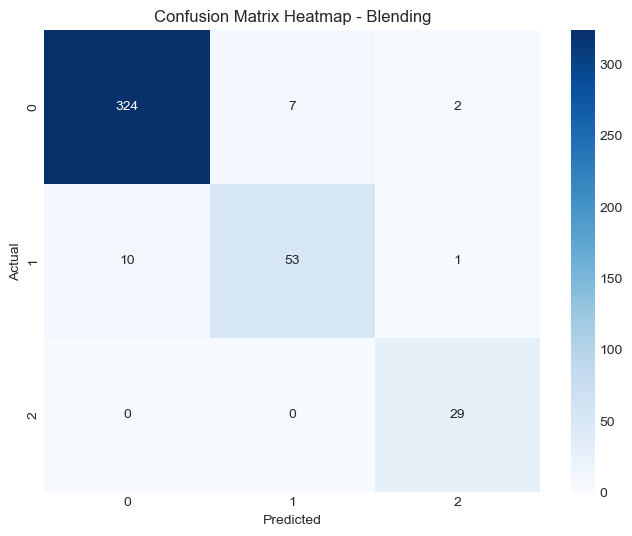

In [39]:
plot_confusion_matrix_heatmap(y_test, voting_y_pred, 'Blending')

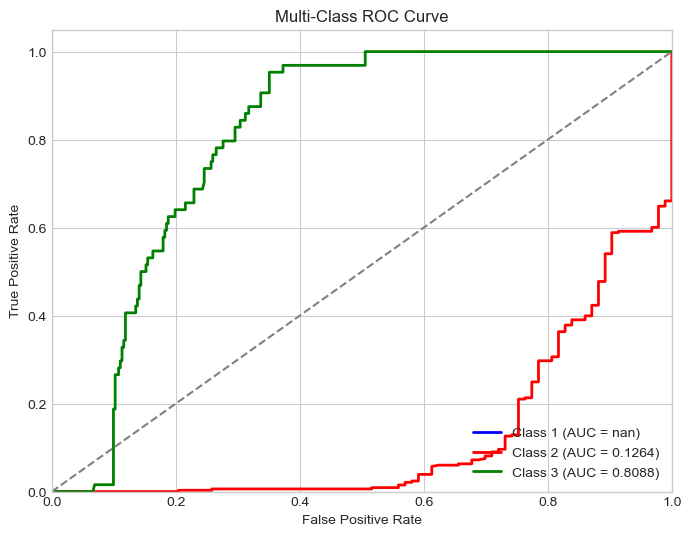

In [40]:
plot_multi_class_roc(voting_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Stacking Classifier with Cross-Validation 
</h1>

In [41]:
# Stacking Classifier with Cross-Validation
stacking_model = StackingClassifier(
    estimators=[('xgb', xgb_model), ('rf', rf_model)],
    final_estimator=LogisticRegression(),  # Meta-model
    cv=5  # Cross-validation folds in Stacking Classifier
)

# Fit Stacking Model
stacking_model.fit(X_train, y_train)

# Cross-Validation Scores
cv_scores = cross_val_score(stacking_model, X_train, y_train, cv=5, scoring='accuracy')

# Predictions on Test Set
stacking_y_pred = stacking_model.predict(X_test)

# Accuracy
stacking_accuracy = accuracy_score(y_test, stacking_y_pred)

# Classification Report & Confusion Matrix for Stacking
print("Stacking Classification Report")
print(classification_report(y_test, stacking_y_pred))
print("Stacking Confusion Matrix")
print(confusion_matrix(y_test, stacking_y_pred))

# Accuracy of Stacking
print(f"Stacking Accuracy: {stacking_accuracy:.4f}")

# Cross-Validation Results
print(f"Cross-Validation Accuracy Scores: {cv_scores}")
print(f"Mean Cross-Validation Accuracy: {cv_scores.mean():.4f}")

# Calculate MCC for the model's predictions
mcc_stacking = matthews_corrcoef(y_test,stacking_y_pred)

# Print MCC
print(f"Matthews Correlation Coefficient (MCC): {mcc_stacking :.4f}")

Stacking Classification Report
              precision    recall  f1-score   support

         1.0       0.97      0.98      0.97       333
         2.0       0.90      0.84      0.87        64
         3.0       0.90      0.97      0.93        29

    accuracy                           0.96       426
   macro avg       0.92      0.93      0.93       426
weighted avg       0.96      0.96      0.96       426

Stacking Confusion Matrix
[[325   6   2]
 [  9  54   1]
 [  1   0  28]]
Stacking Accuracy: 0.9554
Cross-Validation Accuracy Scores: [0.94411765 0.94411765 0.92941176 0.93529412 0.96764706]
Mean Cross-Validation Accuracy: 0.9441
Matthews Correlation Coefficient (MCC): 0.8760


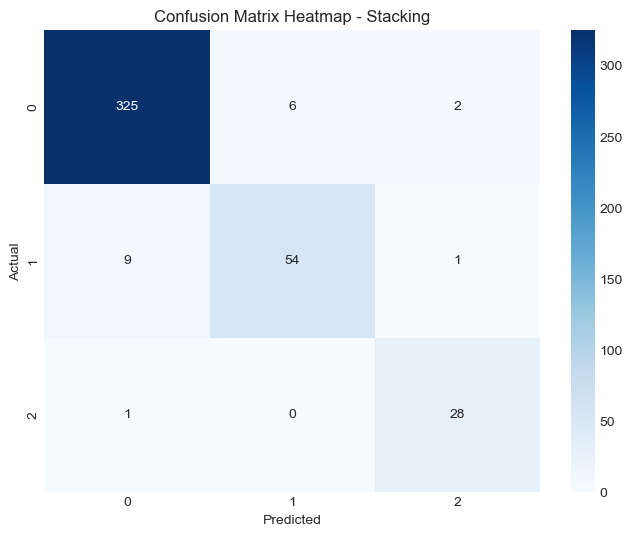

In [42]:
plot_confusion_matrix_heatmap(y_test, stacking_y_pred, 'Stacking')

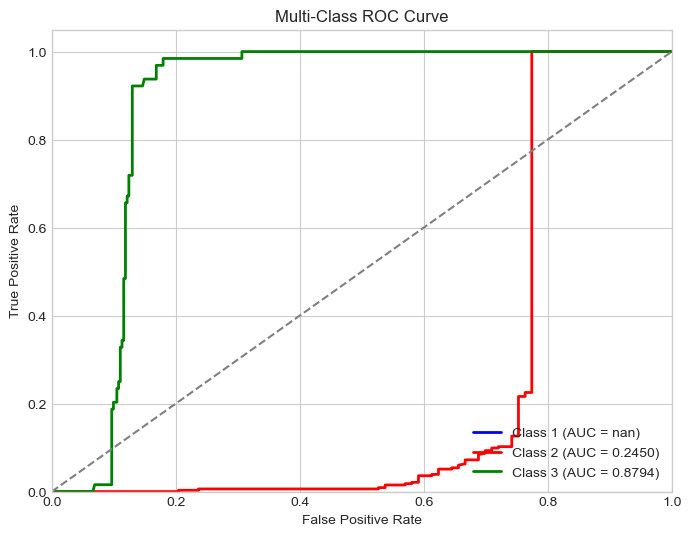

In [43]:
plot_multi_class_roc(stacking_model ,X_test, y_test, num_classes=3)

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Model Comparison - Accuracy
</h1>

In [44]:
import plotly.graph_objs as go

# Data for the bar plot
models = ['Logistic Regression', 'SVM', 'Random Forest', 'KNN', 'XGBoost', 'Stacking', 'Blending']
accuracies = [log_accuracy, svm_accuracy, rf_accuracy, knn_accuracy, xgb_accuracy, stacking_accuracy, voting_accuracy]

# Create a bar plot
bar_fig = go.Figure()

# Add bar trace
bar_fig.add_trace(go.Bar(
    x=models,
    y=accuracies,
    marker_color='#66C2A5'
))

# Update layout with increased size
bar_fig.update_layout(
    title='Model Comparison - Accuracy',
    xaxis_title='Models',
    yaxis_title='Accuracy',
    yaxis=dict(range=[0.8, 1.0]),  # Set y-axis limits
    xaxis_tickangle=-45,  # Rotate x-axis labels for better readability
    width=800,  # Increase width
    height=800   # Increase height
)

# Show the figure
bar_fig.show()


NameError: name 'xgb_accuracy' is not defined

<h1 style="color:#800080; text-align:left; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.1);">
  ● Model Comparison - Matthews Correlation Coefficient (MCC)
</h1>

In [45]:
# Model names and corresponding MCC values
models = ['Logistic Regression', 'SVM', 'Random Forest', 'KNN', 'XGBoost', 'Stacking', 'Blending']
mcc_values = [mcc_log, mcc_svm, mcc_rf, mcc_knn, mcc_XGb, mcc_stacking, mcc_voting]

# Create a bar plot
mcc_fig = go.Figure()

# Add bar trace
mcc_fig.add_trace(go.Bar(
    x=models,
    y=mcc_values,
    marker_color='#66C2A5'
))

# Update layout with increased size
mcc_fig.update_layout(
    title='Model Comparison - MCC',
    xaxis_title='Models',
    yaxis_title='Matthews Correlation Coefficient (MCC)',
    yaxis=dict(range=[0.0, 1.0]),  # Set y-axis limits
    xaxis_tickangle=-45,  # Rotate x-axis labels for better readability
    width=800,  # Increase width
    height=700   # Increase height
)

# Show the figure
mcc_fig.show()



NameError: name 'mcc_XGb' is not defined

In [40]:
d={'Models':models,'Accuracies':accuracies,'MCC':mcc_values}
Models_comparison=pd.DataFrame(d)


from IPython.display import display, HTML
# Sort the DataFrame by 'Accuracies' and reset the index
Models_comparison_sorted = Models_comparison.sort_values(by='Accuracies', ascending=False).reset_index(drop=True)
# Define the HTML table string with inline CSS styling
html_table = """
<table style="width:60%; margin:auto; border-collapse:collapse; font-family:Georgia, serif; font-size:18px; text-align:center;">
  <thead>
    <tr style="background-color:#4A90E2; color:white; border:2px solid #66C2A5;">
      <th style="padding:12px;">Models</th>
      <th style="padding:12px;">Accuracies</th>
      <th style="padding:12px;">MCC</th>
    </tr>
  </thead>
  <tbody>
"""
# Add table rows dynamically from the DataFrame
for _, row in Models_comparison_sorted.iterrows():
    html_table += f"""
    <tr style="border-bottom:1px solid #ddd;">
      <td style="padding:12px; background-color:#E6F9E6;">{row['Models']}</td>
      <td style="padding:12px; background-color:#F0F4C3;">{row['Accuracies']:.6f}</td>
      <td style="padding:12px; background-color:#E6F9E6;">{row['MCC']:.6f}</td>
    </tr>
    """
# Close the HTML table
html_table += """
  </tbody>
</table>
"""
# Display the HTML table
display(HTML(html_table))

Models,Accuracies,MCC
XGBoost,0.960094,0.889860
Stacking,0.955399,0.876789
Blending,0.955399,0.876789
Random Forest,0.946009,0.847387
KNN,0.915493,0.757509
SVM,0.903756,0.730215
Logistic Regression,0.877934,0.665549


<div style="background-color:#E6F9E6; border:2px solid #66C2A5; padding:20px; border-radius:10px; box-shadow: 0 2px 4px 0 rgba(0,0,0,0.1); font-family:Georgia, serif;">
  <h1 style="color:#4A90E2; text-shadow: 1px 1px #FFF; text-align:center;">Conclusion</h1>
  <p style="color:#333; font-size:16px;">
    After training and evaluating various machine learning models for fetal health classification, the <strong>XGBoost</strong> model demonstrated superior performance. With an accuracy of <strong>96.01%</strong> and an MCC (Matthews Correlation Coefficient) of <strong>0.8899</strong>, XGBoost stands out as the most reliable option for predicting fetal health status based on CTG data.
  </p>
  <p style="color:#333; font-size:16px;">
    Ensemble methods such as <strong>Stacking</strong> and <strong>Blending</strong> also performed well, achieving accuracies of <strong>95.54%</strong> with an MCC of <strong>0.8768</strong>. However, they fell slightly behind XGBoost. The <strong>Random Forest</strong> model achieved an accuracy of <strong>94.60%</strong> and MCC of <strong>0.8474</strong>, positioning it as a strong alternative.
  </p>
  <p style="color:#333; font-size:16px;">
    While <strong>K-Nearest Neighbors (KNN)</strong> and <strong>Support Vector Machine (SVM)</strong> provided acceptable results with accuracies of <strong>91.55%</strong> and <strong>90.38%</strong>, their performance was significantly lower compared to the ensemble models. Lastly, <strong>Logistic Regression</strong> yielded the lowest performance with an accuracy of <strong>87.79%</strong> and MCC of <strong>0.6655</strong>.
  </p>
  <p style="color:#333; font-size:16px;">
    In conclusion, the <strong>XGBoost</strong> model is the recommended choice for fetal health classification due to its high accuracy and balanced performance. Its use could assist in early diagnosis, helping healthcare professionals intervene before complications arise, ultimately contributing to reducing child and maternal mortality.
  </p>
</div>


<div style="background-color:#F0F4C3; border:2px solid #66C2A5; padding:30px; border-radius:12px; box-shadow:0 3px 6px rgba(0, 0, 0, 0.1); text-align:center; font-family:'Georgia', serif;">
    <h2 style="color:#4A90E2; font-size:28px; text-shadow:1px 1px 3px rgba(0, 0, 0, 0.1);">
        Thank You!
    </h2>
    <p style="color:#333; font-size:18px; line-height:1.6;">
        We truly appreciate your time and effort in reviewing this analysis. Your valuable feedback and suggestions are always welcomed! 
        Thank you for being a part of this journey toward learning and growth. Together, we can achieve great things in data science!
    </p>
    <p style="color:#333; font-size:18px; line-height:1.6;">
        Feel free to reach out with your comments and insights. Let\'s continue learning and building together!
    </p>
    <p style="color:#333; font-size:18px; line-height:1.6;">
        <strong>Best regards,</strong><br>
        Faiz Siddiqui
    </p>
</div>